## Camera Calibration with OpenCV

In [1]:
# based on https://github.com/udacity/CarND-Camera-Calibration/blob/master/camera_calibration.ipynb
import glob
import cv2
import numpy as np

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ...., (6,9,0)
objp = np.zeros((6 * 9, 3), np.float32)
objp[:, :2] = np.mgrid[0:9, 0:6].T.reshape(-1, 2)

# Arrays to store object points and image points from all the images.
objpoints = []  # 3d points in real world space
imgpoints = []  # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)


In [2]:
def cal_undistort(img):
    img_size = (img.shape[1], img.shape[0])
    # Do camera calibration given object points and image points
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    return cv2.undistort(img, mtx, dist, None, mtx)

In [3]:
import matplotlib.pyplot as plt
% matplotlib inline

def plot_two_images_in_line(org, edited, title_org, title_edited, cmap=None):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(org)
    ax1.set_title(title_org, fontsize=50)
    ax2.imshow(edited, cmap=cmap)
    ax2.set_title(title_edited, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

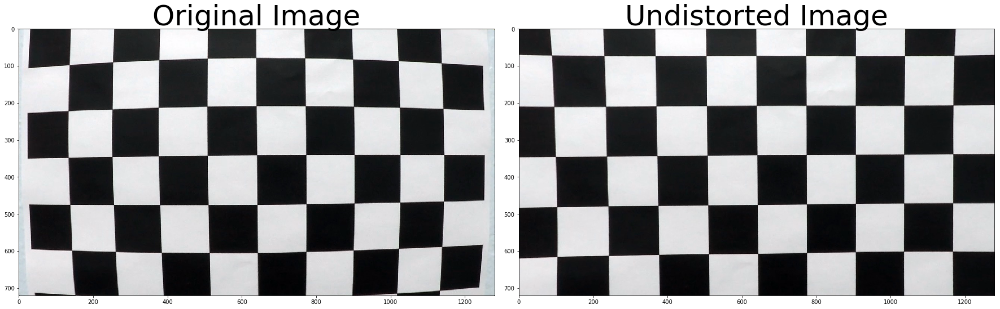

In [4]:
img_test_distort = cv2.imread(images[0])
img_test_undistorted = cal_undistort(img_test_distort)

plot_two_images_in_line(img_test_distort, img_test_undistorted, 'Original Image', 'Undistorted Image')

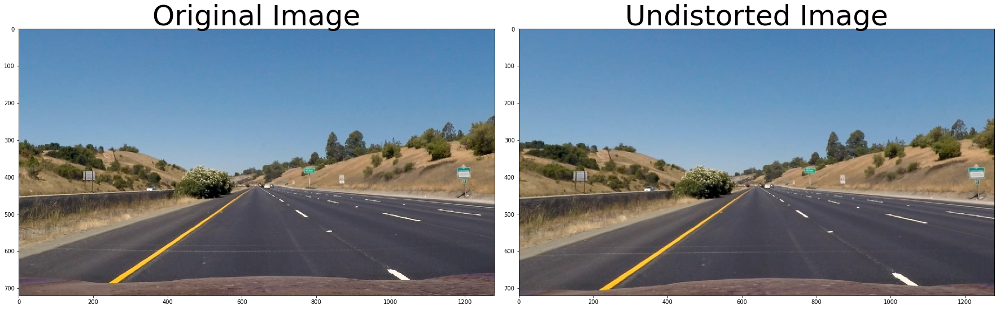

In [5]:
img = cv2.imread("./test_images/straight_lines1.jpg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
un_dist_img = cal_undistort(img)

plot_two_images_in_line(img, un_dist_img, 'Original Image', 'Undistorted Image')

## Transform Perspective

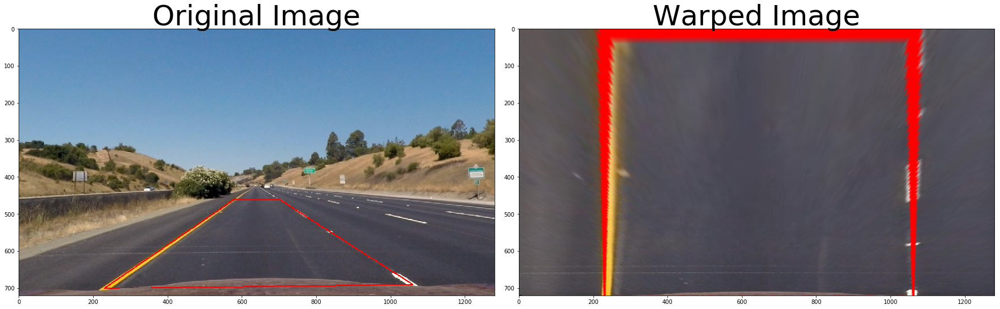

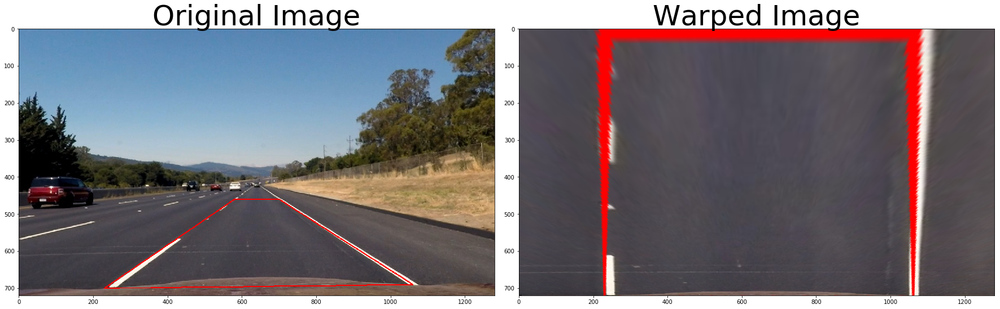

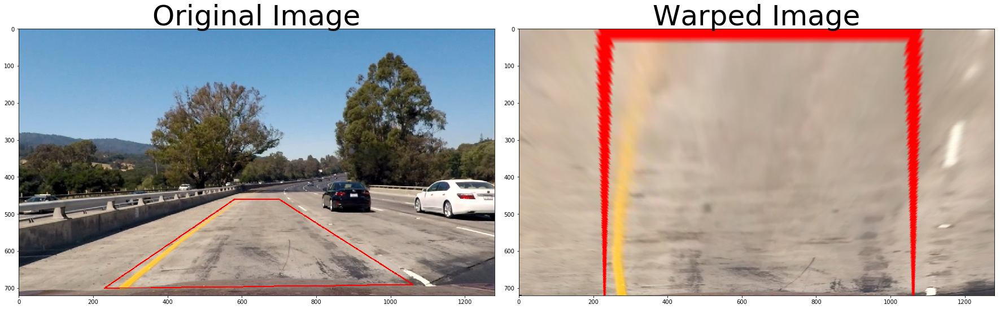

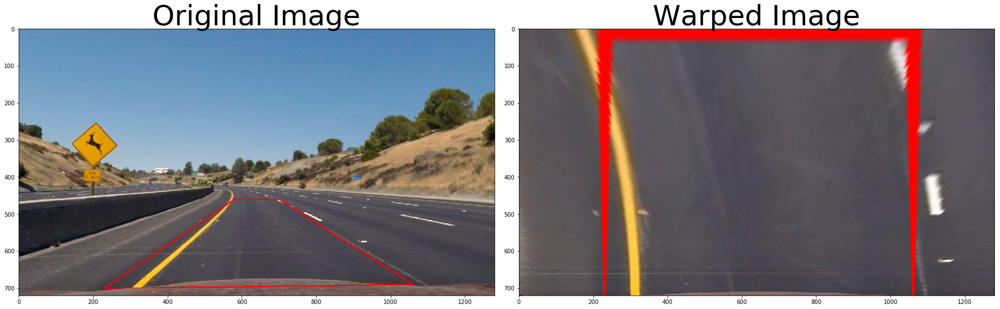

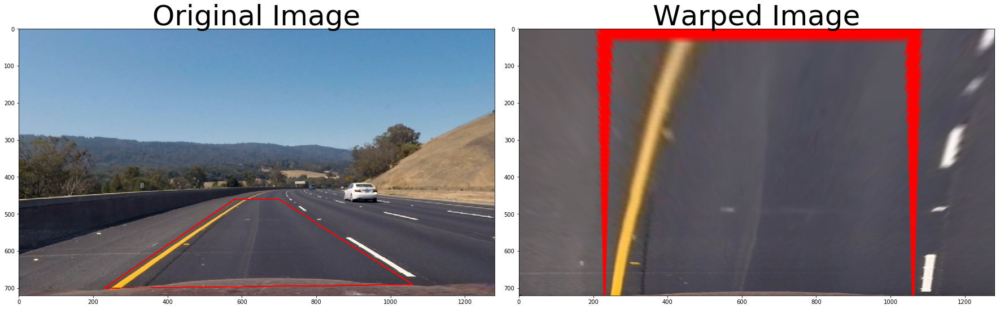

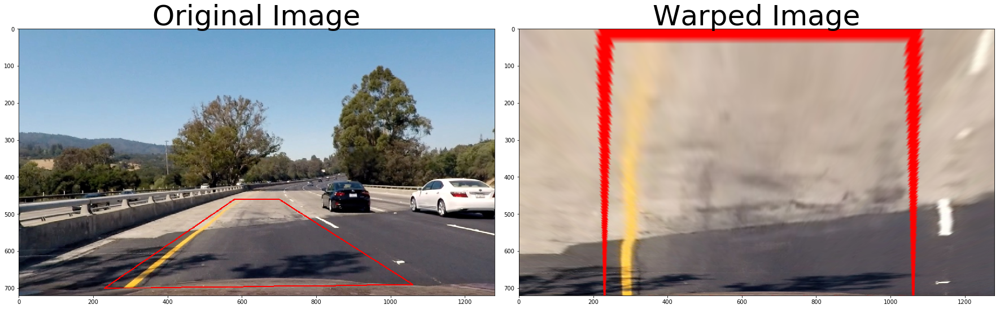

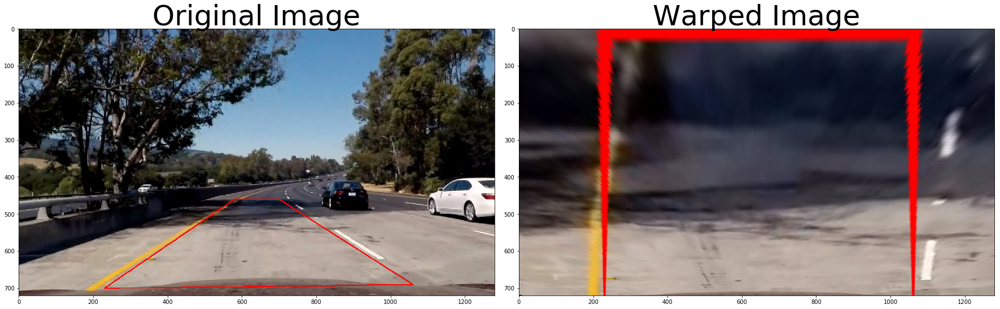

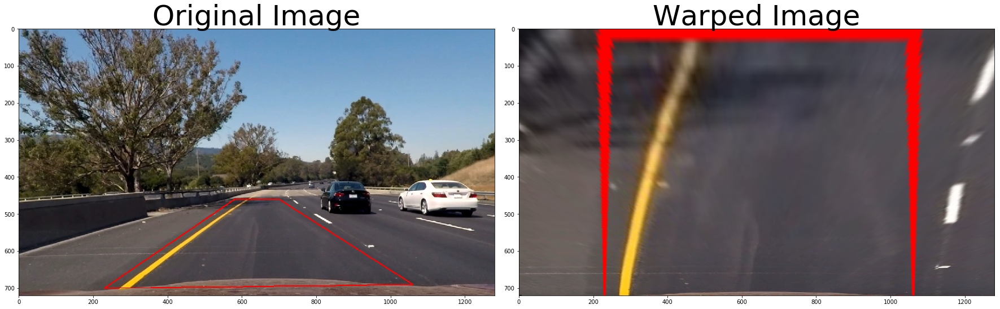

In [6]:
test_images = glob.glob('./test_images/*.jpg')

max_y = cv2.imread(test_images[0]).shape[0]
src = np.float32([[230, 700], [580, 460], [700, 460], [1060, 690]])
dest = np.float32([[230, max_y], [230, 0], [1060, 0], [1060, max_y]])

M = cv2.getPerspectiveTransform(src, dest)
Minv = cv2.getPerspectiveTransform(dest, src)


def warp(img):
    img_size = (img.shape[1], img.shape[0])
    return cv2.warpPerspective(img, M, img_size)


for idx, fname in enumerate(test_images):
    img2 = cv2.imread(fname)
    img2 = cal_undistort(img2)
    img2_size = (img2.shape[1], img2.shape[0])
    cv2.line(img2, (230, 700), (580, 460), color=[0, 0, 255], thickness=2)
    cv2.line(img2, (580, 460), (700, 460), color=[0, 0, 255], thickness=2)
    cv2.line(img2, (700, 460), (1060, 690), color=[0, 0, 255], thickness=2)
    cv2.line(img2, (1060, 690), (230, 700), color=[0, 0, 255], thickness=2)
    dst2 = warp(img2)
    
    plot_two_images_in_line(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB), cv2.cvtColor(dst2, cv2.COLOR_BGR2RGB), 'Original Image', 'Warped Image')

## Image Edge Detecion

In [7]:
def pipeline(img, sx_thresh=(20, 100), sy_thresh=(20, 100), s_thresh=(170, 255),  l_thresh=(100, 255)):
    img = np.copy(img)
    
    # Convert to HLS color space and separate the L and S channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]
    
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Sobel y
    sobely = cv2.Sobel(l_channel, cv2.CV_64F, 0, 1) # Take the derivative in y
    abs_sobely = np.absolute(sobely) # Absolute y
    scaled_sobel = np.uint8(255*abs_sobely/np.max(abs_sobely))
    
    # Threshold y gradient
    sybinary = np.zeros_like(scaled_sobel)
    sybinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold s channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Threshold l channel
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    
    
    combined = np.zeros_like(scaled_sobel)
    combined[((sxbinary == 1) & (sybinary == 1)) | ((s_binary == 1) & (l_binary == 1))] = 1
    return combined

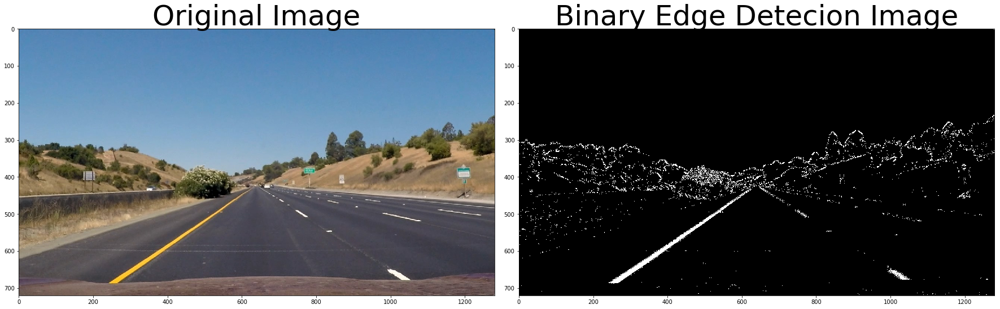

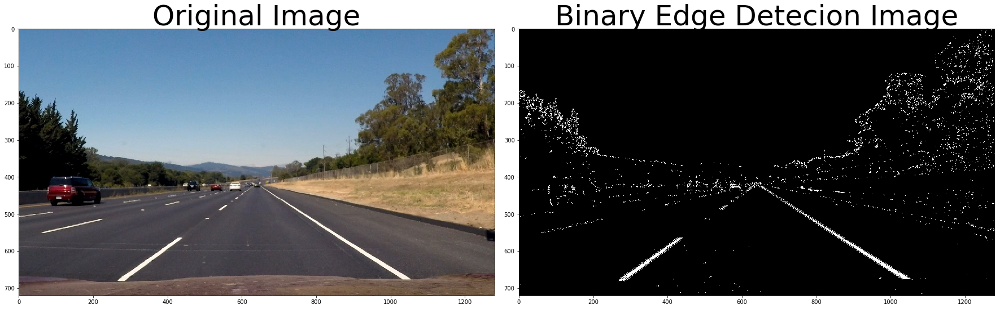

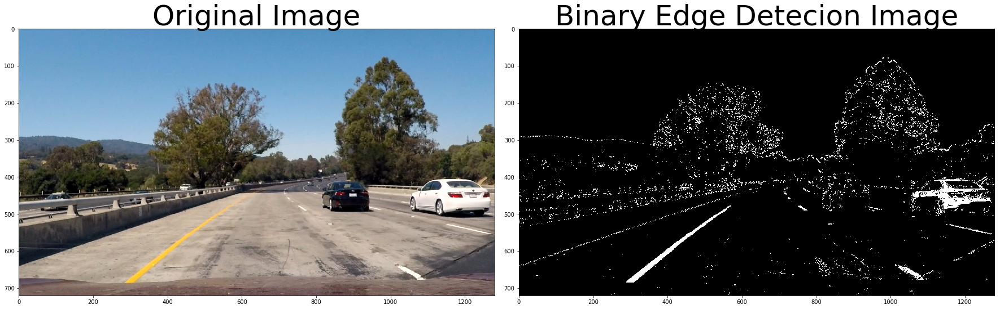

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


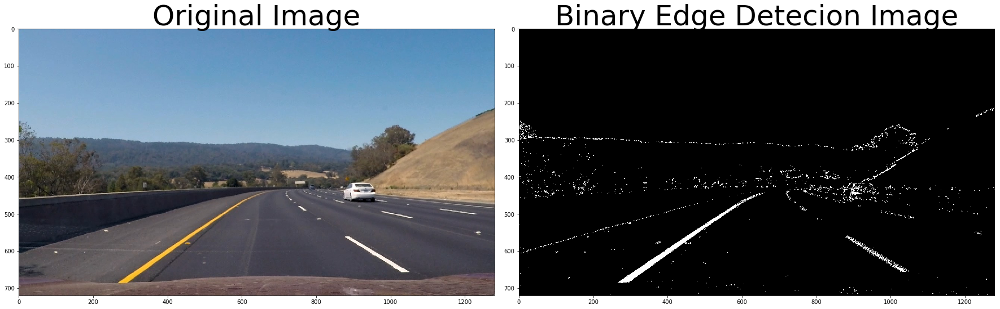

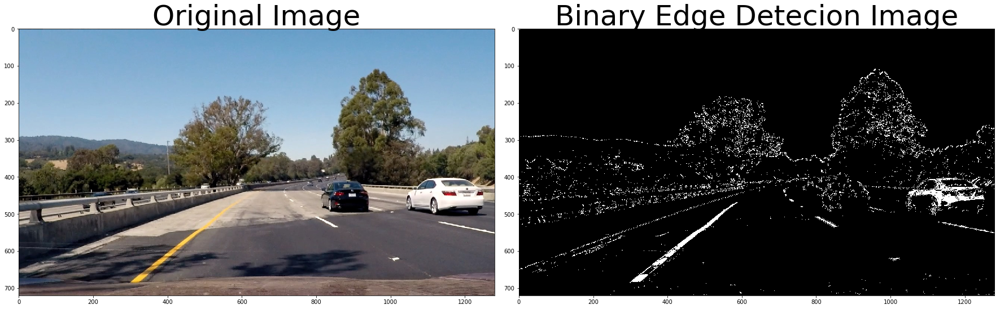

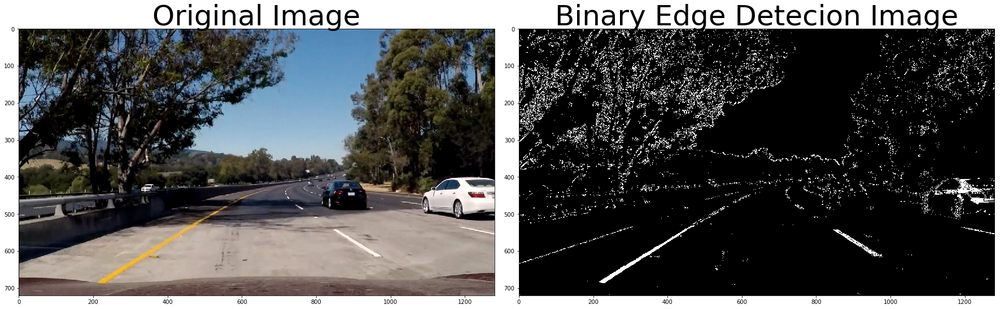

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [8]:
test_images = glob.glob('./test_images/*.jpg')

for test_image in test_images:
    image = cv2.imread(test_image)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    combined = pipeline(image);

    plot_two_images_in_line(image, combined, 'Original Image', 'Binary Edge Detecion Image', cmap='gray')

## Combine Undistortion, Image Edge Detecion & Transform Perspective

In [9]:
def preprocess_img(img_path):
    image = cv2.imread(img_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    image_processed = cal_undistort(image)
    image_processed = pipeline(image_processed);
    image_processed = warp(image_processed)

    return image_processed

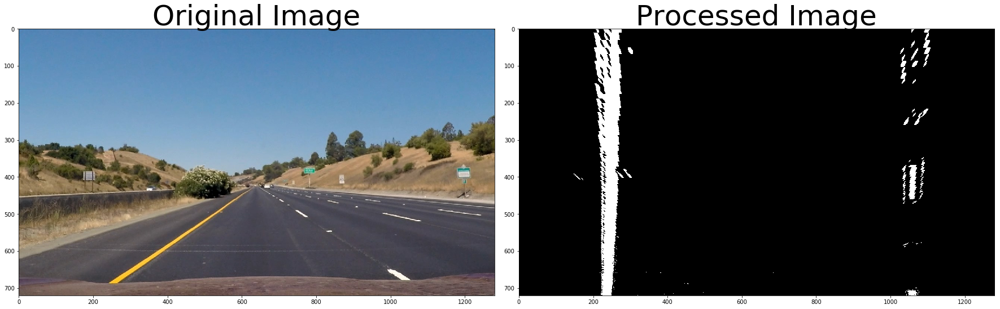

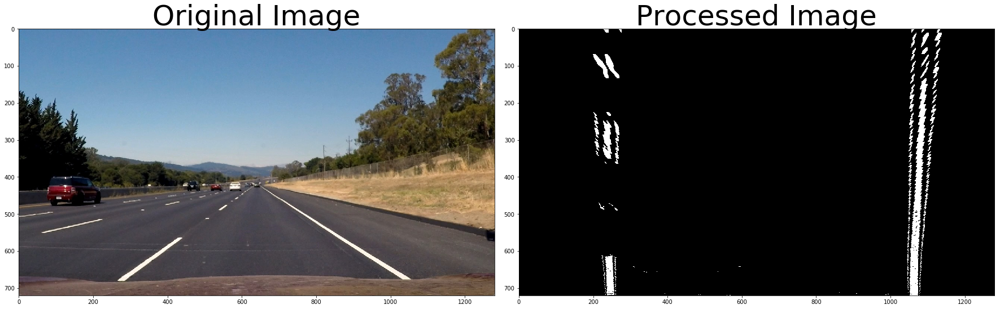

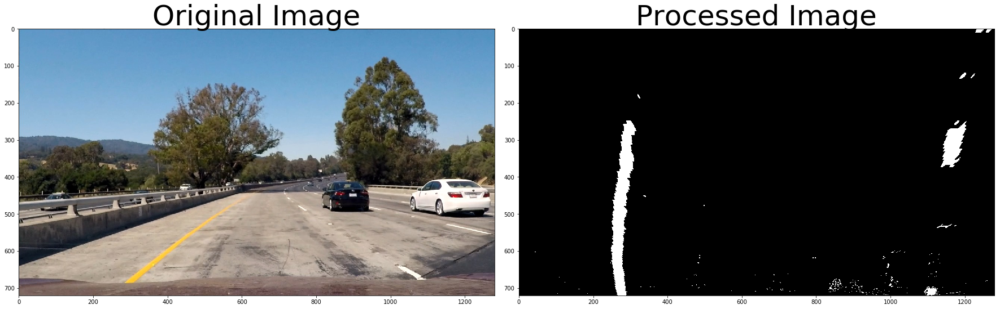

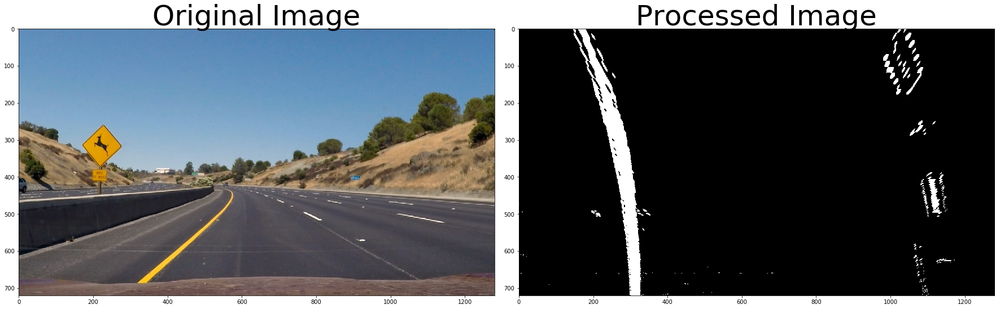

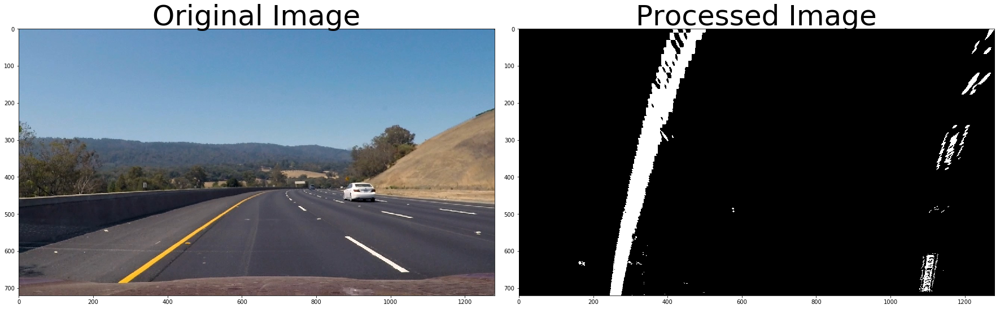

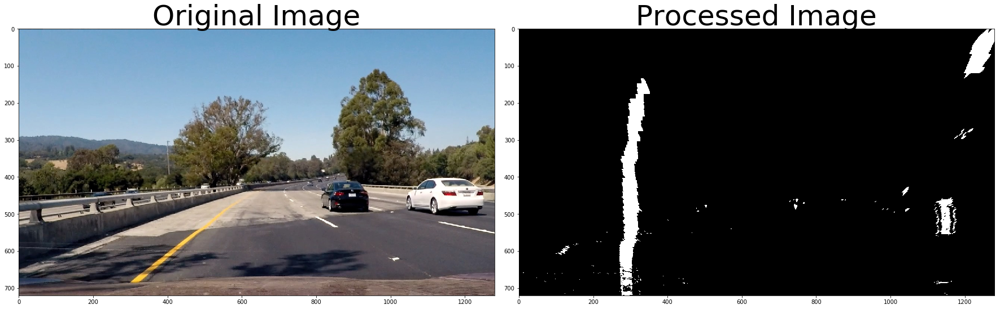

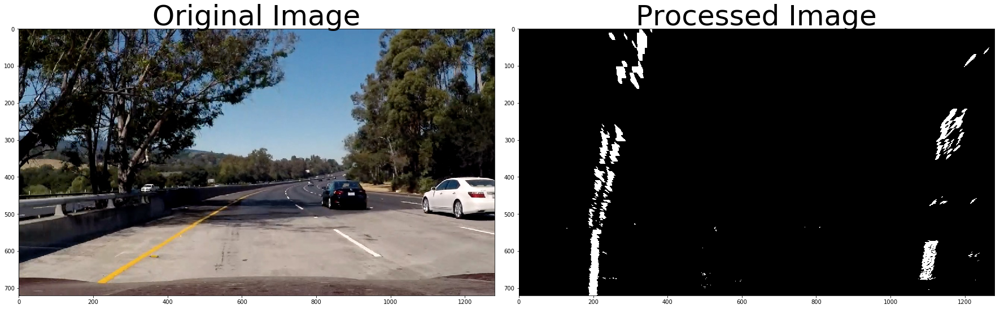

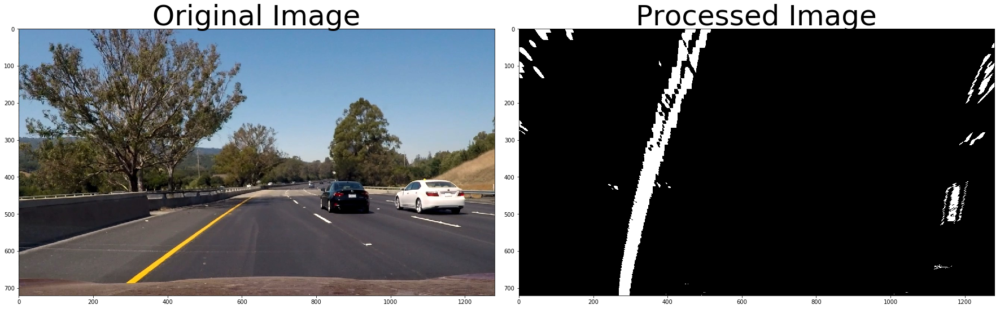

In [10]:
test_images = glob.glob('./test_images/*.jpg')

for test_image in test_images:
    image = cv2.imread(test_image)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    image_processed = preprocess_img(test_image)

    plot_two_images_in_line(image, image_processed, 'Original Image', 'Processed Image', cmap='gray')

## Finding the Lines

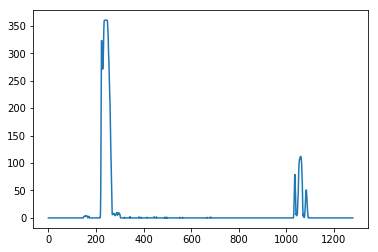

In [11]:
preprocessed_img = preprocess_img("./test_images/straight_lines1.jpg")

histogram = np.sum(preprocessed_img[preprocessed_img.shape[0]//2:,:], axis=0)
plt.plot(histogram)

In [12]:
def window_mask(width, height, img_ref, center, level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0] - (level + 1) * height):int(img_ref.shape[0] - level * height),
    max(0, int(center - width / 2)):min(int(center + width / 2), img_ref.shape[1])] = 1
    return output


def find_window_centroids(image, window_width, window_height, margin):
    window_centroids = []  # Store the (left,right) window centroid positions per level
    window = np.ones(window_width)  # Create our window template that we will use for convolutions

    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 

    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3 * image.shape[0] / 4):, :int(image.shape[1] / 2)], axis=0)
    l_center = np.argmax(np.convolve(window, l_sum)) - window_width / 2
    r_sum = np.sum(image[int(3 * image.shape[0] / 4):, int(image.shape[1] / 2):], axis=0)
    r_center = np.argmax(np.convolve(window, r_sum)) - window_width / 2 + int(image.shape[1] / 2)

    # Add what we found for the first layer
    window_centroids.append((l_center, r_center))

    # Go through each layer looking for max pixel locations
    for level in range(1, (int)(image.shape[0] / window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(
            image[int(image.shape[0] - (level + 1) * window_height):int(image.shape[0] - level * window_height), :],
            axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width / 2
        l_min_index = int(max(l_center + offset - margin, 0))
        l_max_index = int(min(l_center + offset + margin, image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index]) + l_min_index - offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center + offset - margin, 0))
        r_max_index = int(min(r_center + offset + margin, image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index]) + r_min_index - offset
        # Add what we found for that layer
        window_centroids.append((l_center, r_center))

    return window_centroids

In [13]:
# window settings
window_width = 50 
window_height = 144 # Break image into 5 vertical layers since image height is 720
margin = 100 # How much to slide left and right for searching

def sliding_window_search(img_path):
    preprocessed_img = preprocess_img(img_path) * 255.0
    window_centroids = find_window_centroids(preprocessed_img, window_width, window_height, margin)

    # If we found any window centers
    if len(window_centroids) > 0:

        # Points used to draw all the left and right windows
        l_points = np.zeros_like(preprocessed_img)
        r_points = np.zeros_like(preprocessed_img)

        # Go through each level and draw the windows
        for level in range(0, len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width, window_height, preprocessed_img, window_centroids[level][0], level)
            r_mask = window_mask(window_width, window_height, preprocessed_img, window_centroids[level][1], level)
            # Add graphic points from window mask here to total pixels found
            l_points[(l_points == 255) | ((l_mask == 1))] = 255
            r_points[(r_points == 255) | ((r_mask == 1))] = 255

        # Draw the results
        template = np.array(r_points + l_points, np.uint8)  # add both left and right window pixels together
        zero_channel = np.zeros_like(template)  # create a zero color channel
        template = np.array(cv2.merge((zero_channel, template, zero_channel)), np.uint8)  # make window pixels green
        warpage = np.array(cv2.merge((preprocessed_img, preprocessed_img, preprocessed_img)),
                           np.uint8)  # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0)  # overlay the orignal road image with window results       

    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((preprocessed_img, preprocessed_img, preprocessed_img)), np.uint8)

    return output

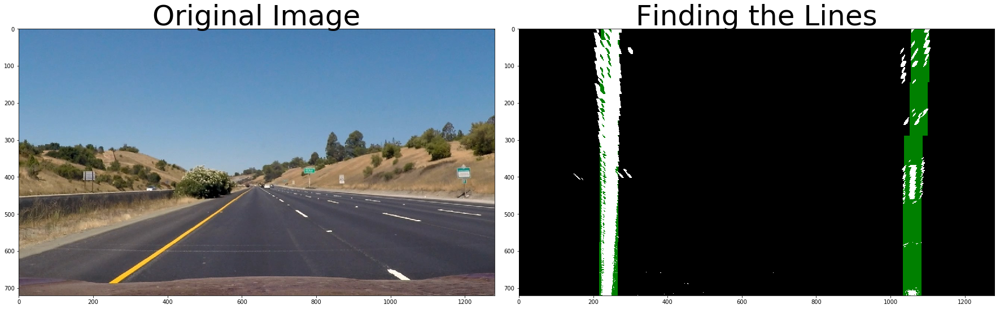

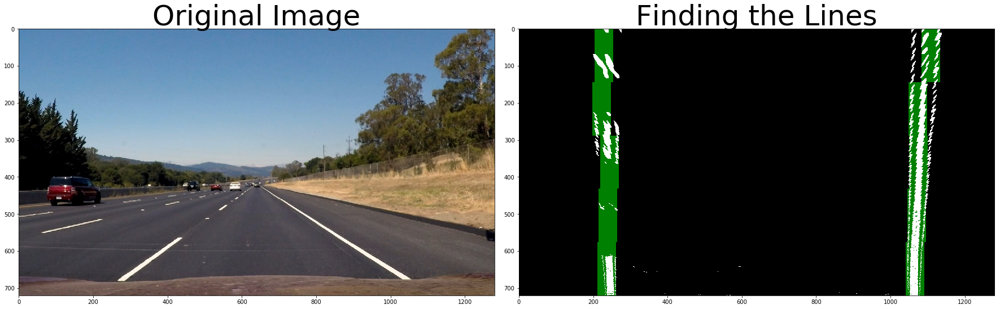

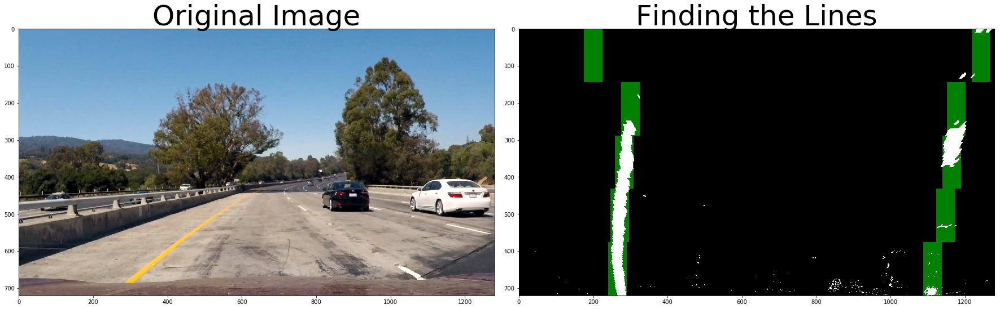

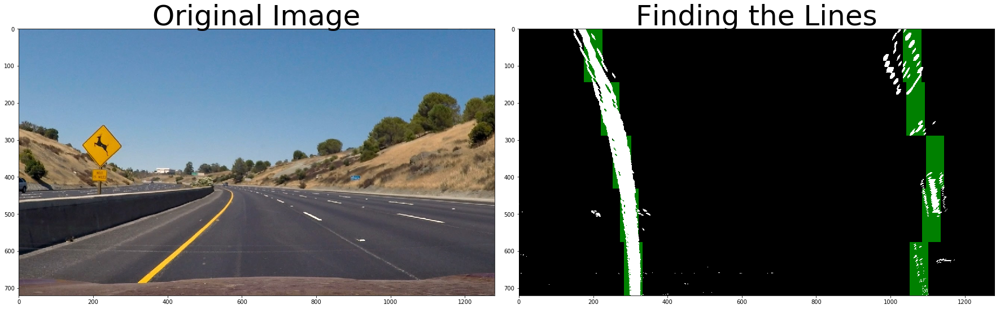

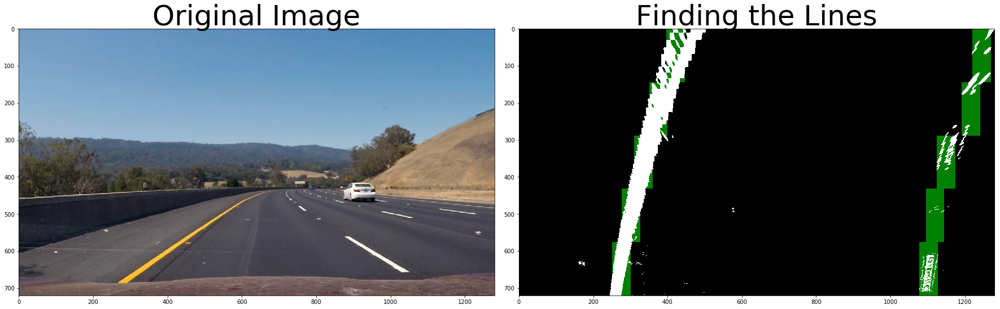

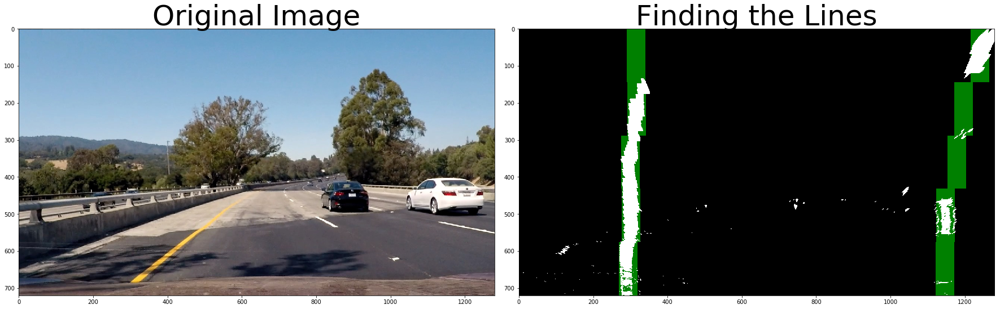

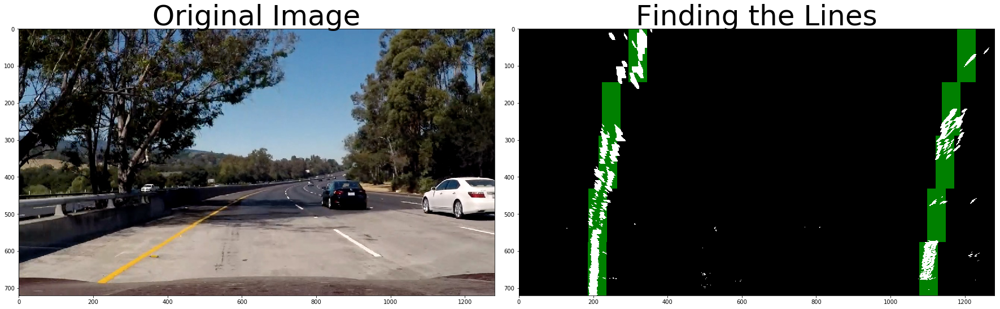

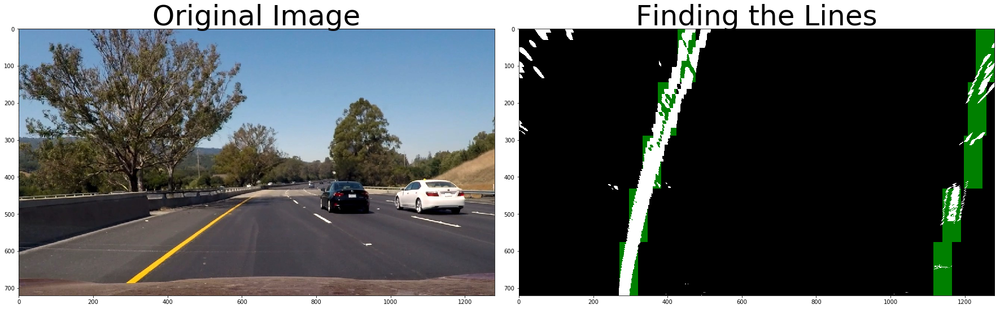

In [14]:
test_images = glob.glob('./test_images/*.jpg')

for test_image in test_images:
    image = cv2.imread(test_image)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    image_lines = sliding_window_search(test_image)

    plot_two_images_in_line(image, image_lines, 'Original Image', 'Finding the Lines')

## Measuring Curvature

In [15]:
def init_find_curvature(binary_warped, show_images=False):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[np.int(binary_warped.shape[0] / 2):, :], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped)) * 255

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0] / 2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0] / nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window + 1) * window_height
        win_y_high = binary_warped.shape[0] - window * window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        if show_images:
            # Draw the windows on the visualization image
            cv2.rectangle(out_img, (win_xleft_low, win_y_low), (win_xleft_high, win_y_high), (0, 255, 0), 2)
            cv2.rectangle(out_img, (win_xright_low, win_y_low), (win_xright_high, win_y_high), (0, 255, 0), 2)
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (
            nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (
            nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    if show_images:
        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        plt.imshow(out_img)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        plt.show()

    return left_fit, right_fit

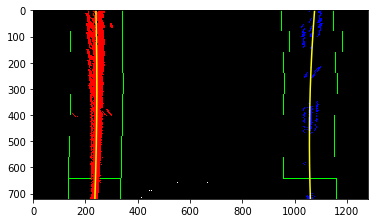

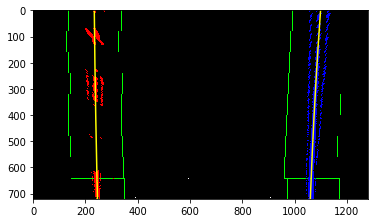

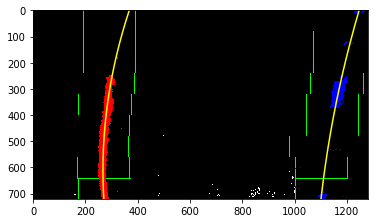

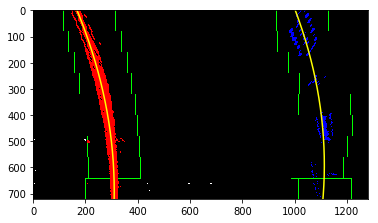

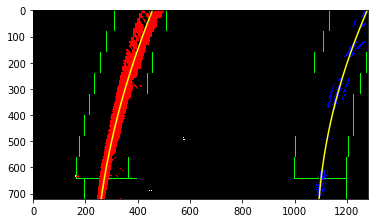

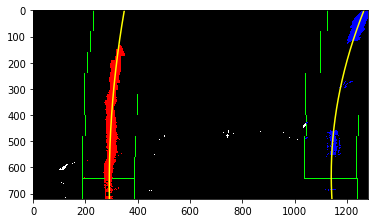

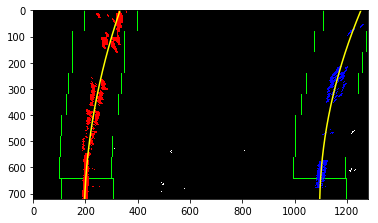

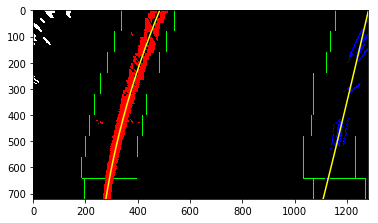

In [16]:
test_images = glob.glob('./test_images/*.jpg')

for test_image in test_images:
    binary_warped = preprocess_img(test_image)
    init_find_curvature(binary_warped, True)

In [17]:
def next_find_curvature(binary_warped, previous_left_fit, previous_right_fit, show_images=False):
    # Assume you now have a new warped binary image
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (
        previous_left_fit[0] * (nonzeroy ** 2) + previous_left_fit[1] * nonzeroy + previous_left_fit[2] - margin)) & (
                          nonzerox < (
                          previous_left_fit[0] * (nonzeroy ** 2) + previous_left_fit[1] * nonzeroy + previous_left_fit[
                              2] + margin)))
    right_lane_inds = (
        (nonzerox > (
        previous_right_fit[0] * (nonzeroy ** 2) + previous_right_fit[1] * nonzeroy + previous_right_fit[2] - margin)) & (
            nonzerox < (
            previous_right_fit[0] * (nonzeroy ** 2) + previous_right_fit[1] * nonzeroy + previous_right_fit[2] + margin)))

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    if show_images:
        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
        left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
        right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2]

        # Create an image to draw on and an image to show the selection window
        out_img = np.dstack((binary_warped, binary_warped, binary_warped)) * 255
        window_img = np.zeros_like(out_img)
        # Color in left and right line pixels
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

        # Generate a polygon to illustrate the search window area
        # And recast the x and y points into usable format for cv2.fillPoly()
        left_line_window1 = np.array([np.transpose(np.vstack([left_fitx - margin, ploty]))])
        left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx + margin, ploty])))])
        left_line_pts = np.hstack((left_line_window1, left_line_window2))
        right_line_window1 = np.array([np.transpose(np.vstack([right_fitx - margin, ploty]))])
        right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx + margin, ploty])))])
        right_line_pts = np.hstack((right_line_window1, right_line_window2))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(window_img, np.int_([left_line_pts]), (0, 255, 0))
        cv2.fillPoly(window_img, np.int_([right_line_pts]), (0, 255, 0))
        result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
        plt.imshow(result)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        plt.show()

    return left_fit, right_fit

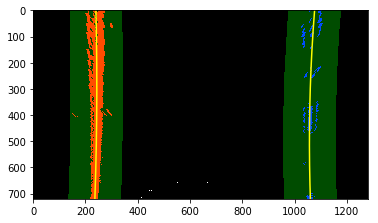

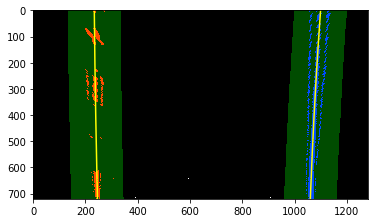

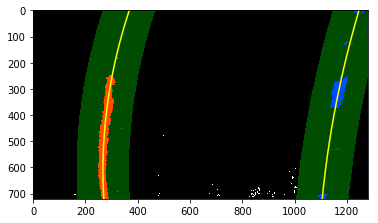

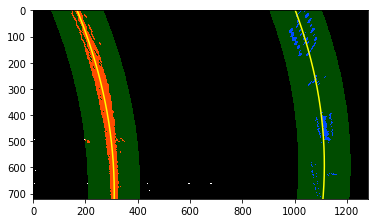

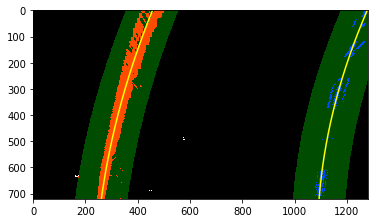

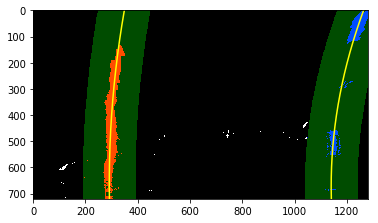

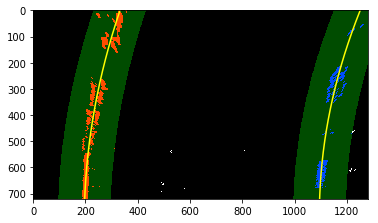

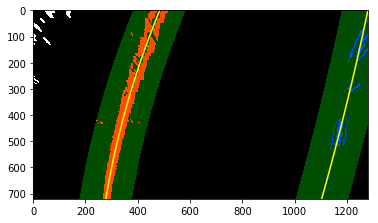

In [18]:
test_images = glob.glob('./test_images/*.jpg')

for test_image in test_images:
    binary_warped = preprocess_img(test_image)
    left_fit, right_fit = init_find_curvature(binary_warped)
    next_find_curvature(binary_warped, left_fit, right_fit, True)

## Measuring Curvature

In [19]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30 / 720  # meters per pixel in y dimension
xm_per_pix = 3.7 / 700  # meters per pixel in x dimension


def calc_fit_real(fit, height = 1280):
    
    y = np.linspace(0, height-1, height)
    x = fit[0]*y**2 + fit[1]*y + fit[2]

    fit_real = np.polyfit(y*ym_per_pix, x*xm_per_pix, 2)
    
    return fit_real


def calc_curverad(fit, y):
    return ((1 + (2*fit[0]*y  + fit[1])**2)**1.5) / np.absolute(2*fit[0])

In [20]:
test_images = glob.glob('./test_images/*.jpg')

for test_image in test_images:
    binary_warped = preprocess_img(test_image)
    left_fit, right_fit = init_find_curvature(binary_warped)
    left_fit, right_fit = next_find_curvature(binary_warped, left_fit, right_fit)
    fit_left_real = calc_fit_real(left_fit)
    fit_right_real = calc_fit_real(right_fit)
    print(calc_curverad(fit_left_real, 1280 * ym_per_pix), 'm', calc_curverad(fit_right_real, 1280 * ym_per_pix), 'm')

4078.68332893 m 2109.42928033 m
16416.5667209 m 7156.15413261 m
611.439357865 m 1200.50821325 m
560.604797136 m 519.992440445 m
889.488513353 m 669.079702212 m
1240.50888561 m 600.491509693 m
795.545145227 m 645.251933646 m
966.041540899 m 3265.17167269 m


In [21]:
width_in_m = 1280 * xm_per_pix
height_in_m = 1280 * ym_per_pix

def calc_offset_from_center(fit_left, fit_right, y, vehicle_pos_x):      
    x_left  = fit_left[0] *y**2 + fit_left[1] *y + fit_left[2]
    x_right = fit_right[0]*y**2 + fit_right[1]*y + fit_right[2]
    
    return vehicle_pos_x - (x_left + x_right)/2

# Pipeline for Videos

In [22]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

In [23]:
lines_detected = []
font = cv2.FONT_HERSHEY_SIMPLEX


def video_pipeline(image):
    reference_line = None
    try:
        for i in range(max(0, len(lines_detected) - 5), len(lines_detected)):
            line = lines_detected[i]
            if line.detected:
                reference_line = line
                break

        last_fit = None

        if reference_line != None:
            last_fit = reference_line.current_fit

        line = Line()

        image_undistorted = cal_undistort(image)
        image_binary = pipeline(image_undistorted);
        warped = warp(image_binary)

        if last_fit == None:
            left_fit, right_fit = init_find_curvature(warped)
        else:
            left_fit, right_fit = next_find_curvature(warped, last_fit[0], last_fit[1])

        real_left_fit = calc_fit_real(left_fit)
        real_right_fit = calc_fit_real(right_fit)

        left_radius = calc_curverad(real_left_fit, 1280 * ym_per_pix)
        right_radius = calc_curverad(real_right_fit, 1280 * ym_per_pix)

        is_radius_resonable = abs(left_radius) > 10 and abs(right_radius) > 10
        is_almost_straight = abs(left_radius) > 500 and abs(right_radius) > 500
        is_similar_radius = abs(left_radius - right_radius) / abs(max(left_radius, right_radius)) < 0.4

        if is_radius_resonable:  # and ( is_almost_straight or is_similar_radius ):
            line.detected = True
            line.current_fit = (left_fit, right_fit)

            if is_almost_straight:
                radius_of_curvature = left_radius
            else:
                radius_of_curvature = (left_radius + right_radius) / 2

            line_base_pos = calc_offset_from_center(real_left_fit, real_right_fit, height_in_m, width_in_m / 2)

            line.radius_of_curvature = radius_of_curvature
            line.line_base_pos = line_base_pos

        else:
            line.detected = False
            if last_fit != None:
                left_fit = last_fit[0]
                right_fit = last_fit[1]
                radius_of_curvature = reference_line.radius_of_curvature
                line_base_pos = reference_line.line_base_pos

        lines_detected.append(line)

        if line.detected or last_fit != None:
            ploty = np.linspace(0, warped.shape[0] - 1, warped.shape[0])

            left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
            right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2]

            # Create an image to draw the lines on
            warp_zero = np.zeros_like(warped).astype(np.uint8)
            color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

            # Recast the x and y points into usable format for cv2.fillPoly()
            pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
            pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
            pts = np.hstack((pts_left, pts_right))

            # Draw the lane onto the warped blank image
            cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))

            # Warp the blank back to original image space using inverse perspective matrix (Minv)
            newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0]))
            # Combine the result with the original image
            result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)

            cv2.putText(result, 'Curvature: {:8.2f}m, Car off center: {:4.2f}m'.format(radius_of_curvature, line_base_pos),
                        (100, 100), font, 1, (255, 255, 255), 2)

            return result
        else:
            return image
    except :
        return image


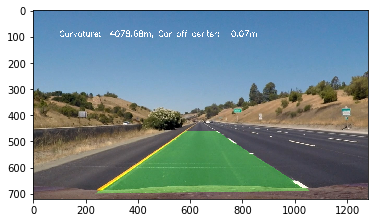

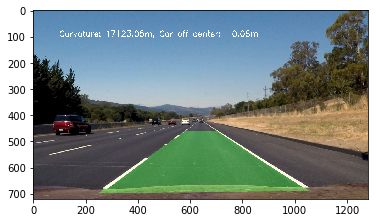

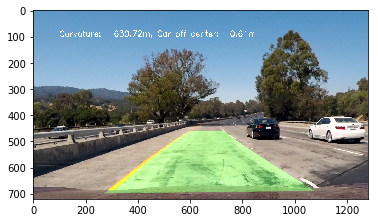

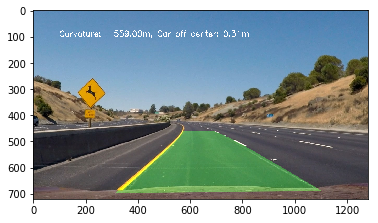

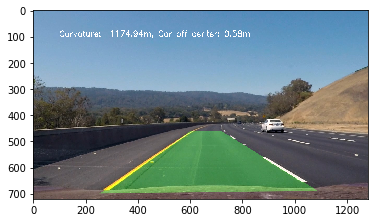

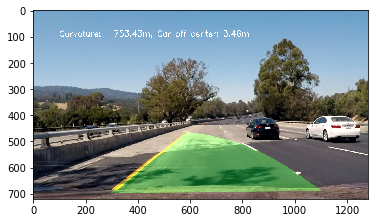

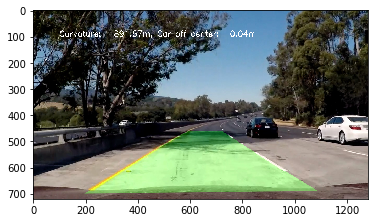

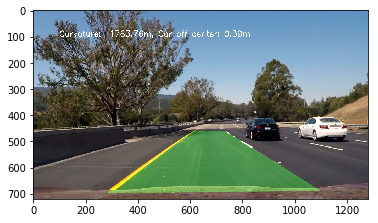

In [24]:
test_images = glob.glob('./test_images/*.jpg')

lines_detected = []
for test_image in test_images:
    image = cv2.imread(test_image)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    plt.imshow(video_pipeline(image))
    plt.show()

In [25]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

lines_detected = []
white_output = 'project_video_detected.mp4'
clip1 = VideoFileClip("./project_video.mp4")
white_clip = clip1.fl_image(video_pipeline) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video project_video_detected.mp4
[MoviePy] Writing video project_video_detected.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [14:36<00:00,  1.34it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_detected.mp4 

Wall time: 14min 37s
